# Final Project 

My research questions are:
- how are corals distributed globally and what are their current status?
- what are the main causes of massive coral bleaching?
- what can we learn from a specific area of coral reefs, their bleaching and recovery? 

In [1]:
# to download osm data
import osmnx as ox

# to manipulate data
import pandas as pd

# to manipulate and visualize spatial data
import geopandas as gpd

# to provide basemaps 
import contextily as ctx

# for plotting
import matplotlib.pyplot as plt
import numpy as np

/opt/conda/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.1-CAPI-1.13.3) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


## Data cleaning

In [2]:
Coral = gpd.read_file('CoralBleaching.csv')

### Fixing wrong types of columns and create a new `DATE` column

In [3]:
Coral.LON = Coral.LON.astype('float')
Coral.LAT = Coral.LAT.astype('float')
Coral['YEAR'] = pd.to_numeric(Coral['YEAR'])
Coral['DAY'] = 1
Coral['MONTH'] = Coral['MONTH'].replace('','1')
Coral['DATE'] = pd.to_datetime(Coral[['YEAR', 'MONTH','DAY']])
Coral['DATE'] = Coral.DATE.astype('datetime64')

### Getting rid of errors

In [4]:
Coral.loc[6087, 'LAT'] = -10.269

In [5]:
Coral.loc[308,'LON'] = -87.5410
Coral.loc[354,'LON'] = -88

I noticed that there are at least three errors/typos in the dataset where there is a missing decimal point or a missing minus mark to indicate a negative number, so the above codes are used to fix that problem.

## Create a map that shows the global distribution of corals

In [6]:
config = {
  "version": "v1",
  "config": {
    "visState": {
      "filters": [
        {
          "dataId": [
            "coral"
          ],
          "id": "n7mfoab1c",
          "name": [
            "DATE"
          ],
          "type": "timeRange",
          "value": [
            -220924800000,
            1338508800000
          ],
          "enlarged": True,
          "plotType": "histogram",
          "animationWindow": "free",
          "yAxis": None
        }
      ],
      "layers": [
        {
          "id": "9l0sz9a",
          "type": "point",
          "config": {
            "dataId": "coral",
            "label": "Point",
            "color": [
              255,
              153,
              31
            ],
            "columns": {
              "lat": "LAT",
              "lng": "LON",
              "altitude": None
            },
            "isVisible": True,
            "visConfig": {
              "radius": 20.7,
              "fixedRadius": False,
              "opacity": 0.56,
              "outline": False,
              "thickness": 2,
              "strokeColor": None,
              "colorRange": {
                "name": "Custom Palette",
                "type": "custom",
                "category": "Custom",
                "colors": [
                  "#bd0026",
                  "#e59962",
                  "#ea5842",
                  "#dfd4bb",
                  "#57deda"
                ]
              },
              "strokeColorRange": {
                "name": "Global Warming",
                "type": "sequential",
                "category": "Uber",
                "colors": [
                  "#5A1846",
                  "#900C3F",
                  "#C70039",
                  "#E3611C",
                  "#F1920E",
                  "#FFC300"
                ]
              },
              "radiusRange": [
                0,
                50
              ],
              "filled": True
            },
            "hidden": False,
            "textLabel": [
              {
                "field": None,
                "color": [
                  255,
                  255,
                  255
                ],
                "size": 18,
                "offset": [
                  0,
                  0
                ],
                "anchor": "start",
                "alignment": "center"
              }
            ]
          },
          "visualChannels": {
            "colorField": {
              "name": "BLEACHING_SEVERITY",
              "type": "string"
            },
            "colorScale": "ordinal",
            "strokeColorField": None,
            "strokeColorScale": "quantile",
            "sizeField": None,
            "sizeScale": "linear"
          }
        }
      ],
      "interactionConfig": {
        "tooltip": {
          "fieldsToShow": {
            "coral": [
              {
                "name": "COUNTRY",
                "format": None
              },
              {
                "name": "YEAR",
                "format": None
              },
              {
                "name": "BLEACHING_SEVERITY",
                "format": None
              }
            ]
          },
          "compareMode": False,
          "compareType": "absolute",
          "enabled": True
        },
        "brush": {
          "size": 0.5,
          "enabled": False
        },
        "geocoder": {
          "enabled": True
        },
        "coordinate": {
          "enabled": False
        }
      },
      "layerBlending": "normal",
      "splitMaps": [],
      "animationConfig": {
        "currentTime": None,
        "speed": 1
      }
    },
    "mapState": {
      "bearing": 0,
      "dragRotate": False,
      "latitude": 3.9526845667448818,
      "longitude": -91.69035730652317,
      "pitch": 0,
      "zoom": 0.518428794045724,
      "isSplit": False
    },
    "mapStyle": {
      "styleType": "dark",
      "topLayerGroups": {},
      "visibleLayerGroups": {
        "label": True,
        "road": True,
        "border": False,
        "building": True,
        "water": True,
        "land": True,
        "3d building": False
      },
      "threeDBuildingColor": [
        9.665468314072013,
        17.18305478057247,
        31.1442867897876
      ],
      "mapStyles": {}
    }
  }
}

In [7]:
from keplergl import KeplerGl
coral_df = pd.DataFrame(data=Coral)
map = KeplerGl(height=600, width=800, data={'coral':coral_df},config=config)
map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [{'dataId': ['coral'], 'id': 'n7mfoab1c',…

From the map, we can see how coral bleaching has occured throughout the years. It is interesting to note that the very first collections of bleaching data in this dataset is located in the Caribbean region. As well, it is interesting that the last few years of data show a lot of corals with an unknown bleaching severity and few severe bleaching can be found. The reason is unclear, but it would be irrational to jump to the conclusion that the health status of corals worldwide has improved.

In [8]:
Coral['DATE'] = Coral.DATE.astype(str) #in order to save the Kepler map as an html file, it seems that it is necessay to leave the timeline function behind.

In [9]:
map.save_to_html(file_name='coral.html',read_only=True)

Map saved to coral.html!


In [10]:
temp = pd.read_csv('temperature-anomaly.csv')

In [11]:
temp = temp.loc[temp['Entity']=='Global']

In [12]:
import plotly.express as px

In [13]:
line_graph = px.line(temp, x="Year", y="Median temperature anomaly from 1961-1990 average", title='Global Temperature Change from 1850 to 2019')
line_graph.show()

The line graph above shows that global average temperature has been rising rapidly since the 1970s. Even if we are looking at only a 0.8 degree Celsius increase, this is a lot when we consider the whole planet. This data is downloaded from _Our World in Data_ https://ourworldindata.org/co2-and-other-greenhouse-gas-emissions.

In [14]:
line_graph.write_html("temperature.html") #save the above bar chart as an html file

## Investigation into the Caribbean region

Since the Caribbean region has a longstanding data collection of coral health status, and since this region has one of the most diverse coral habitats in the world, I believe it would be valuable to dive more into this area and to look at the events that have happened in this region over the past few decades.

First of all, it might be interesting to look at corals in the Caribbean in the very beginning in the 1960s.

In [15]:
coral = pd.read_csv('CoralBleaching.csv')

In [16]:
coral.LON = coral.LON.astype('float')
coral.LAT = coral.LAT.astype('float')
coral['YEAR'] = pd.to_numeric(coral['YEAR'])
coral.loc[308,'LON'] = -87.5410
coral.loc[354,'LON'] = -88
coral.loc[6087, 'LAT'] = -10.269

In [17]:
coral = gpd.GeoDataFrame(coral, 
                     crs='EPSG:4326',
                     geometry=gpd.points_from_xy(coral.LON, coral.LAT))

In [18]:
coral.REGION.unique()

array([nan, 'Africa', 'Americas', 'Asia', 'Australia', 'Middle East',
       'Pacific'], dtype=object)

### Trim the dataset to only look at the Caribbean region before 1980

In [19]:
c = coral.loc[(coral['YEAR']<1980)&(coral['REGION']=='Americas')]
c = pd.DataFrame(data=c[['COUNTRY','YEAR','BLEACHING_SEVERITY','REMARKS']])

In [20]:
pd.set_option('display.max_colwidth', None)

In [21]:
c = c.sort_values(by=['YEAR'])
c

,COUNTRY,YEAR,BLEACHING_SEVERITY,REMARKS
1759,Jamaica,1963,Severity Unknown,"Some of the surviving corals bleached (Goreau, 1964)."
1882,Colombia,1969,Severity Unknown,
2276,Puerto Rico,1969,Severity Unknown,An intensive and extensive bleaching event occurred on coral reefs of southwestern Puerto Rico in 1969 (pers comm from Almodovar and Atwood). The bleaching was probably caused by 38.1 cm of rain during a hurricane that preceded the bleaching (pers comm f
2199,Florida (USA),1973,Medium,Millepora complanata showed the greatest incidence of discoloration. Other species were not as severely affected.
1980,Panama,1976,Severity Unknown,At irregularly low tides with two hour exposures of the reef. Reported by Glynn (1976). Colonies bleach within a few days of exposure and after 2 or 3 weeks are covered with algae.
1943,Ecuador,1977,Severity Unknown,Extent Unspecified; The reefs recovered in about 4 to 6 weeks.
245,Netherlands Antilles,1979,Medium,"In June 1979, an extensive and long-term bleaching event began in Bonaire. It developed progressively and became most extensive and intense in September and October, 1979. The event ended in February 1980. Bleaching occurred on all but the windward coa"
290,Virgin Islands (British),1979,Low,Actual cause of bleaching is not known. Partial mortality
291,Virgin Islands (British),1979,Severity Unknown,Extent Unspecified
2277,Puerto Rico,1979,Severity Unknown,Goenaga and Canals (1979) reported bleaching of Millepora complanata in a small area of Puerto Rico in 1979. This damage was apparently caused by lowered salinity.


The above table shows that bleaching has been recorded in the Caribbean region as early as 1963. Despite the fact that the `BLEACHING_SEVERITY` column barely contains meaningful information, we are able to understand the situation of Caribbean corlas from 1963 to 1980 from the `REMARKS` column.

In [22]:
c.to_html('Caribbeantable.html') #save the dataframe as an html

### Create a dataset that shows the impact of the 2005 hurricanes

In [23]:
caribbean = coral.loc[((coral['YEAR'] == 2006)|(coral['YEAR'] == 2005)|(coral['YEAR'] == 2004)) & (coral['REGION']=='Americas')]
unknown = caribbean.loc[caribbean['BLEACHING_SEVERITY']=='Severity Unknown']

In [24]:
unknown = unknown.dropna(subset=['REMARKS'])

In [25]:
unknown = unknown[['COUNTRY','YEAR','MONTH','REMARKS']]

In [26]:
unknown = unknown.sort_values(by=['MONTH'])
unknown

,COUNTRY,YEAR,MONTH,REMARKS
1872,Colombia,2005,6.0,"A massive bleaching of corals is taking place since aprox 10-15 days (since late June) at Islas del Rosario (National Natural Park) near the city of Cartagena, Colombia. I was there on holidays during the weekend of 8-10 July and took many photos in shallow waters (down to 5 m) around the Oceanarium at San Martín de Pajarales Island (10°10'37.7""N-75°46'16.2""). Resident people had been noticing the bleaching since about 1-2 weeks before my arrival, associated with extremely warm, and possibly quite brackish waters (from nearby river discharges).<br>\nAlmost all corals were totally white to pale yellow. Some massive star coral colonies (Montastraea annularis and M. faveolata) still had slightly colored basal patches. Brain coral species (Diploria and Colpophyllia) were completely bleached. Porites porites beds were totally white. P. astreoides knobs were from white to light lemon yellow. Siderastrea siderea was less affected with a dark bluish-violet color in several colonies, and a few normally brown. S. radians was apparently not affected (hard to tell, the small encrustations of this species being normally so light). Even Favia fragum golfball corals were fully bleached. Benthic, rubble-dwelling anemones (probably corallymorpharians) were white. Millepora spp. had both white, normal and ""pinto"" (patchy) like colonies-branches. Did not see any Acropora to tell whether the few remaining colonies bleached or not.<br>\n\nIt seemed that deeper corals were less bleached. However, Jaime Rojas, biologist working for both the National Park authorities and the Oceanarium, undertook on July 8 a quick survey around the islands confirming that the phenomenon is widespread. He is making a follow up, and working with daily sea-surface temperature data (possibly salinity too) taken regularly at the Oceanarium. Later on he may make a more detailed report. <br> \nNo sponges had bleached. Even brown encrusting Cliona, which harbor zooxanthellae, were fine. <br>\nPhotos can be seen at http://www.invemar.org.co/redcostera1/invemar/coral-bleaching-photos-by-sven-zea/"
2245,Puerto Rico,2005,6.0,"There are already bleached colonies of the following\ncoral species:\n\n1. Montastraea annularis.\n2. Agaricia agaricites.\n3. Leptoseris cucullata.\n4. Siderastrea siderea.\n5. Diploria clivosa.\n6. Millepora alcicornis.\n<br>Others:\n<br>\nSeveral M. annularis colonies within our\npermanent monitoring site were infected with a \n""white plague-like"" syndrome. So far, there were a few\nalmost completely killed colonies, and several others\nwith >50% mortality. Coral size ranged from about 50\ncm to about 2 m.\n\nThere were also another group of M. cavernosa infected\nwith Black Band Disease."
1371,Bahamas,2005,7.0,"Reef Relief's Craig Quirolo has observed extensive paling on \nDiploria strigosa in the Noname Cay Abacos, Bahamas on July 13. \n<br>This coral is located on top of an isolated 'Coral Rise' in 65 feet \nof water. Surface depth is seven feet. Many Diploria strigosa \ncolonies were in the first stages of coral bleaching"
1888,Colombia,2005,7.0,"Some of the corals were showing signs of stress. Colonies of Millepora complanata were bleached .... with colonies ranging from fully bleached-out to colonies that were partially bleached. While none of the other species of corals were fully bleached, there was some paling observed.\nValentino Duffis, a Fisher Advisor to CORALINA said, ""in his 25 years of fishing the San Andres Archipelago, he had never witnessed the calm weather conditions for as long as he has over the past few months."" His observation was that thermal stress was having an impact on the marine environment. <br>\nDiadema population appeared to be rather abundant and healthy."
1961,Panama,2005,7.0,"All coral species seems to be affected, mostly in shallow waters, but also at depth up to 8m. It seems that water temperature has begun to drop down for now on."
344,Belize,2005,8.0,"Some

In [27]:
unknown.to_html('unknown.html') #save the dataframe as an html

### Create a word cloud based on the remarks

In [28]:
from wordcloud import WordCloud, STOPWORDS

In [29]:
all_text = ' '.join(unknown['REMARKS'])
wordcloud = WordCloud(width=1200, 
                          height=800,
                          background_color="white").generate(all_text)

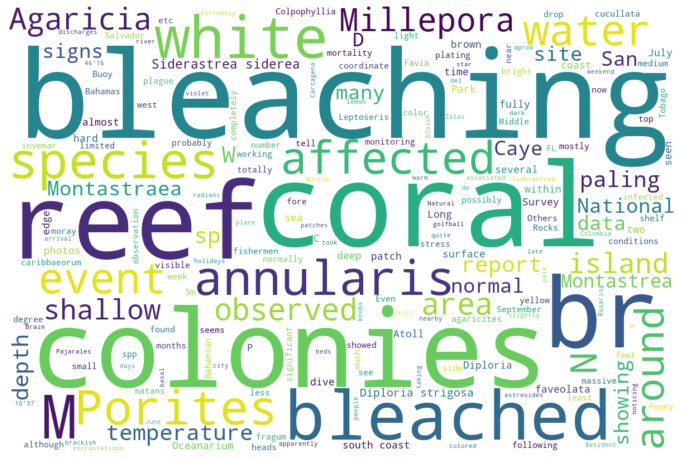

In [30]:
plt.figure(figsize=(12,12))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

From the table and the word cloud above, we can see that a large portion of the corals marked as 'Severity Unknown' actually suffers from quite severe bleaching. Although the reason why they were not classified is unclear, we can still learn a lot from these comments from scientists. The words 'bleaching', 'bleached', and 'white' seem to be the most common words in the comments, which indicate that many of these corals were, indeed, bleaching.

### Visualize with a map

In [31]:
caribbean = caribbean[caribbean.BLEACHING_SEVERITY != 'Severity Unknown'] #in order for the visualization to be more straightforward, I decided to leave out the corals marked as 'Severity Unknown' 

In [32]:
fig_1 = px.scatter_mapbox(caribbean,
                          lat="LAT", 
                          lon="LON",
                          color="BLEACHING_SEVERITY",
                          zoom = 3,
                          animation_frame='YEAR',
                          category_orders={'YEAR':[2004,2005,2006],'BLEACHING_SEVERITY':['No Bleaching','Low','Medium','HIGH']},
                          labels={'BLEACHING_SEVERITY':'Bleaching Severity'},
                          title="Coral Bleaching Severity in the Caribbean Region from 2004 to 2006")
fig_1.update_layout(mapbox_style="carto-darkmatter")
fig_1.show()

In [33]:
fig_1.write_html("fig.html")

This interactive map shows that in 2004, high coral bleaching was observed along the coast of Mexico south of Tulum, while in 2005, bleaching has occurred in all parts of Caribbean. In 2006, high bleaching only occurred on the east coast of Mexico. 

### Visualize the effect of hurricanes with a bar chart

In [34]:
before = caribbean.loc[(caribbean['YEAR']==2005)&(caribbean['MONTH']<=7)]
after = caribbean.loc[(caribbean['YEAR']==2005)&(caribbean['MONTH']>7)]

In [35]:
b = before['BLEACHING_SEVERITY'].value_counts().reset_index()

In [36]:
a= after['BLEACHING_SEVERITY'].value_counts().reset_index()

In [37]:
a

,index,BLEACHING_SEVERITY
0,Low,110
1,Medium,101
2,HIGH,50
3,No Bleaching,26


In [38]:
time = ['After July','After July','After July','After July']
a['time'] = time
a

,index,BLEACHING_SEVERITY,time
0,Low,110,After July
1,Medium,101,After July
2,HIGH,50,After July
3,No Bleaching,26,After July


In [39]:
time_b = ['Before July','Before July','Before July','Before July']
b['time'] = time_b
b

,index,BLEACHING_SEVERITY,time
0,Low,145,Before July
1,No Bleaching,85,Before July
2,Medium,69,Before July
3,HIGH,20,Before July


In [40]:
caribbean2015 = [a,b]
caribbean2015 = pd.concat(caribbean2015)
caribbean2015

,index,BLEACHING_SEVERITY,time
0,Low,110,After July
1,Medium,101,After July
2,HIGH,50,After July
3,No Bleaching,26,After July
0,Low,145,Before July
1,No Bleaching,85,Before July
2,Medium,69,Before July
3,HIGH,20,Before July


In [41]:
fig_2 = px.bar(caribbean2015,
       x='index',
       y='BLEACHING_SEVERITY',
       color='index',
       title='Bleaching in the Caribbean Region Before and After Serious Hurricanes',
       labels={'BLEACHING_SEVERITY':'count','index':'Bleaching Severity'},
       category_orders={"index": ['Severity Unknown','No Bleaching','Low', 'Medium', 'HIGH'],'time':['Before July','After July']},
       facet_col='time'
      )
fig_2.show()

In [42]:
fig_2.write_html("fig2.html") #save the above bar chart as an html file

The bar chart shows a very siginificant change in bleaching severity of corals in the Caribbean region after the major storms hit Central America since July. There is a considerable increase in 'Medium' and 'HIGH' bleaching severity and a decrease in 'No Bleaching' and 'Low.' This shows the tremendous impact the hurricanes had on the reefs in this area. 

In [43]:
caribbean2005 = caribbean.loc[(caribbean['YEAR']==2005)&((caribbean['BLEACHING_SEVERITY']=='HIGH')|(caribbean['BLEACHING_SEVERITY']=='Medium'))]

In [44]:
fig_3 = px.scatter_mapbox(caribbean2005,
                          lat="LAT", 
                          lon="LON",
                          color="BLEACHING_SEVERITY",
                          zoom = 3,
                          animation_frame='MONTH',
                          category_orders={'MONTH':[1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0],'BLEACHING_SEVERITY':['Medium','HIGH']},
                          labels={'BLEACHING_SEVERITY':'Bleaching Severity'},
                          title="Coral Bleaching Severity in the Caribbean Region by Month in 2005")
fig_3.update_layout(mapbox_style="carto-darkmatter")
fig_3.show()

With the strong hurricanes striking the area from July to October, these months are also the time when we see a significant increase in coral bleaching. I am surprised that in these months there is still so much data collected. I could only imagine that the diving conditions would be harsh. 

In [45]:
fig_3.write_html("fig3.html") 

In [46]:
caribbean2005 = caribbean2005.reset_index()

In [47]:
after_hurricane = caribbean2005.loc[(caribbean2005['MONTH']>7)&(caribbean2005['BLEACHING_SEVERITY']=='HIGH')]

In [48]:
config2 = {
  "version": "v1",
  "config": {
    "visState": {
      "filters": [],
      "layers": [
        {
          "id": "rji9uv",
          "type": "point",
          "config": {
            "dataId": "After hurricane",
            "label": "After hurricane",
            "color": [
              177,
              41,
              7
            ],
            "columns": {
              "lat": "LAT",
              "lng": "LON",
              "altitude": None
            },
            "isVisible": True,
            "visConfig": {
              "radius": 34.1,
              "fixedRadius": False,
              "opacity": 0.6,
              "outline": False,
              "thickness": 0.5,
              "strokeColor": None,
              "colorRange": {
                "name": "Global Warming",
                "type": "sequential",
                "category": "Uber",
                "colors": [
                  "#5A1846",
                  "#900C3F",
                  "#C70039",
                  "#E3611C",
                  "#F1920E",
                  "#FFC300"
                ]
              },
              "strokeColorRange": {
                "name": "Global Warming",
                "type": "sequential",
                "category": "Uber",
                "colors": [
                  "#5A1846",
                  "#900C3F",
                  "#C70039",
                  "#E3611C",
                  "#F1920E",
                  "#FFC300"
                ]
              },
              "radiusRange": [
                0,
                50
              ],
              "filled": True
            },
            "hidden": False,
            "textLabel": [
              {
                "field": None,
                "color": [
                  255,
                  255,
                  255
                ],
                "size": 18,
                "offset": [
                  0,
                  0
                ],
                "anchor": "start",
                "alignment": "center"
              }
            ]
          },
          "visualChannels": {
            "colorField": None,
            "colorScale": "quantile",
            "strokeColorField": None,
            "strokeColorScale": "quantile",
            "sizeField": None,
            "sizeScale": "linear"
          }
        }
      ],
      "interactionConfig": {
        "tooltip": {
          "fieldsToShow": {
            "After hurricane": [
              {
                "name": "COUNTRY",
                "format": None
              },
              {
                "name": "REMARKS",
                "format": None
              }
            ]
          },
          "compareMode": False,
          "compareType": "absolute",
          "enabled": True
        },
        "brush": {
          "size": 0.5,
          "enabled": False
        },
        "geocoder": {
          "enabled": False
        },
        "coordinate": {
          "enabled": False
        }
      },
      "layerBlending": "normal",
      "splitMaps": [],
      "animationConfig": {
        "currentTime": None,
        "speed": 1
      }
    },
    "mapState": {
      "bearing": 0,
      "dragRotate": False,
      "latitude": 17.7545,
      "longitude": -74.29713,
      "pitch": 0,
      "zoom": 5,
      "isSplit": False
    },
    "mapStyle": {
      "styleType": "dark",
      "topLayerGroups": {},
      "visibleLayerGroups": {
        "label": True,
        "road": True,
        "border": False,
        "building": True,
        "water": True,
        "land": True,
        "3d building": False
      },
      "threeDBuildingColor": [
        9.665468314072013,
        17.18305478057247,
        31.1442867897876
      ],
      "mapStyles": {}
    }
  }
}

In [49]:
map2 = KeplerGl(height=600, width=800, data={'After hurricane':after_hurricane},config=config2)
map2

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'rji9uv', 'type': '…

The map above shows, in a straightforward way, the distribution of corals that are severely bleached in 2005 in the Caribbean region. By hovering the cursor over the dots, we can also see the remarks made about the status of these corals. These remarks, clearly, are not pleasant to look at, as most of them talk about how the corals are seeing the worst bleaching ever.

## Caribbean coral bleaching and forest cover

Although it is very difficult to establish a correlation between forest cover and coral bleaching in a region, it is nevertheless useful to examine the spatial relationship between the two. There is, certainly, a relationship between the two, especially when we consider huge hurricanes that will wash everything from land to the ocean without the presence of forest to hold soil together. 

In [50]:
forest = gpd.read_file('forest.csv') #this file contains forest cover of each country from 1990 to 2020.

In [51]:
forest = forest[['Code','Year','Forest cover']]
forest.columns = ['iso3','Year','cover']
forest['cover'] = pd.to_numeric(forest.copy()['cover'])

In [52]:
pop = gpd.read_file('worldpop.geojson')

In [53]:
columns_to_keep = [
 'COUNTRY',
 'iso3',
 'geometry']
pop = pop[columns_to_keep]

In [54]:
caribbean_countries = ['MSR','PRI','CYM','AIA','VGB','VIR','VIN','BHS','TCA','ATG','BRB','BLZ','COL','CRI','CUB','DMA','DOM','GLP','MTQ','BLM','MAF','GRD','HTI','HND','JAM','ABW','SXM','MEX','BES','NIC','PAN','KNA','LCA','VCT','TTO','CUW']

I manually created a list of all the iso3 codes of countries in the Caribbean region.

In [55]:
caribbean_pop = pop.loc[pop['iso3'].isin(caribbean_countries)]

In [56]:
caribbean_forest = forest.loc[forest['iso3'].isin(caribbean_countries)]
caribbean_forest_2004= caribbean_forest.loc[caribbean_forest['Year']=='2004']

### Prepare a point file for all the corals marked as high bleaching severity in 2005

In [57]:
caribbean_severe = coral.loc[(coral['REGION']=='Americas')&(coral['BLEACHING_SEVERITY'] == 'HIGH')&(coral['YEAR']==2005)]

In [58]:
caribbean_severe = caribbean_severe.reset_index()

### Create a map to show the distribution of severely-bleached corals and forest covers of surrounding countries

In [59]:
import folium
from folium.plugins import MarkerCluster

In [60]:
bins = list(caribbean_forest_2004["cover"].quantile([0, 0.25, 0.5, 0.75, 1]))

m = folium.Map(location=[15, -90], zoom_start=4)

folium.Choropleth(
    geo_data=caribbean_pop,
    data=caribbean_forest_2004,
    columns=["iso3", "cover"],
    key_on="feature.properties.iso3",
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.5,
    line_weight=0.5,
    highlight=True,
    overlay=False,
    legend_name="Forest cover (%)",
    bins=bins,
    reset=True,
).add_to(m)

marker_cluster = MarkerCluster().add_to(m)
for i in range (len(caribbean_severe)):
    folium.Marker(
    location=[caribbean_severe['LAT'][i], caribbean_severe['LON'][i]],
    popup=caribbean_severe['LOCATION'][i],
    icon=folium.Icon(color="red",icon='bookmark'),
    ).add_to(marker_cluster)

m

In [61]:
m.save('forest_folium.html')

The map above shows that severely-bleached corals are often located near countries with a smaller percentage of forest cover. As we know, the corals in the Caribbean in 2005 are mostly affected by hurricanes, so forest cover may not have a direct impact on these corals. However, it is too early to deny any relationship between bleaching and forest cover.

In [62]:
caribbean_forest = pd.DataFrame(data=caribbean_forest)

In [63]:
caribbean_forest['Year']=pd.to_numeric(caribbean_forest['Year'])

In [64]:
caribbean_forest = caribbean_forest.reset_index()

In [65]:
average = pd.DataFrame(columns=['Year','cover'])

In [66]:
for i in range (1990,2021):
    x=caribbean_forest.loc[caribbean_forest['Year']==i].sum(axis=0).cover
    average.loc[i-1990] = [str(i),x]

In [67]:
average['mean']=average['cover']/31

In [68]:
mean_forest_cover = px.line(average, x="Year", y="mean", title='Mean Forest Cover Change in the Caribbean from 1990 to 2020')
mean_forest_cover.show()

In [69]:
mean_forest_cover.write_html("mean_cover.html") #save the above bar chart as an html file

The above graph shows that the mean forest cover of countries in the Caribbean region has been on steady decline from 1990 to 2010. From 2010 to 2015, there is a slight increase in forest cover, but the average forest cover continued to drop after 2015. 

## Recovery from bleaching

One of the most important things to look at when we want to understand bleaching corals is how they are recovering. Corals are remarkably resilient – even when they turn white, they have a chance of surviving as long as the external stress is removed. That being said, there is no data in the Caribbean region that records corals' recovery from the 2005 hurricanes. Of course, this does not mean that corals there have not recovered, but it is undeniable that the hurricanes had a devastating impact on those corals.

In [70]:
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
from ipywidgets.embed import embed_minimal_html
from ipywidgets import IntSlider

In [71]:
coral = coral[['COUNTRY','MONTH','LAT','LON','YEAR','RECOVERY_CODE','RECOVERY','REMARKS','geometry']]

In [72]:
recovery_code = [0,1,2,3]

### Map world coral recovery

In [73]:
@interact
def scatter_map(recovery=recovery_code):
    display(coral[coral.RECOVERY_CODE == recovery]) 

    fig_4 = px.scatter_mapbox(coral[coral.RECOVERY_CODE == recovery], 
                            lat="LAT", 
                            lon="LON", 
                            zoom=0,
                            labels={'RECOVERY_CODE':'Recovery Code'},
                            hover_data=['RECOVERY'])

    fig_4.update_layout(mapbox_style="carto-darkmatter")

    fig_4.show()
    fig_4.write_html("fig4.html")



interactive(children=(Dropdown(description='recovery', options=(0, 1, 2, 3), value=0), Output()), _dom_classes…

The map and table above show the different degrees of coral bleaching recovery in the world, with 0 being the best recovery and 3 being the least extent. A future direction of this research could be to investigarte more deeply into why some regions recovered while other did not (e.g. coral species, depth, etc.). 

## Conclusion

I honestly cannot belive I produced everything by myself! I also can't believe how much I've learned this quarter in this class! Thank you so much, Yoh! I was distracted by a lot of things happening in muy life this quarter but this class has been so fun, challenging, and inspiring! The more I look into this dataset, the more future possibilities I find. I really appreciate your help!